In [1]:
import sys
import os

parent_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
sys.path.append(parent_dir)

from visual_genome.local import VisualGenome

In [2]:
vg = VisualGenome() # may take couple of minutes to load the data

Script directory: C:\Users\karab\Desktop\Visual Genome Driver\visual_genome
Data directory: C:\Users\karab\Desktop\Visual Genome Driver\data
Loading data...
Data loaded.


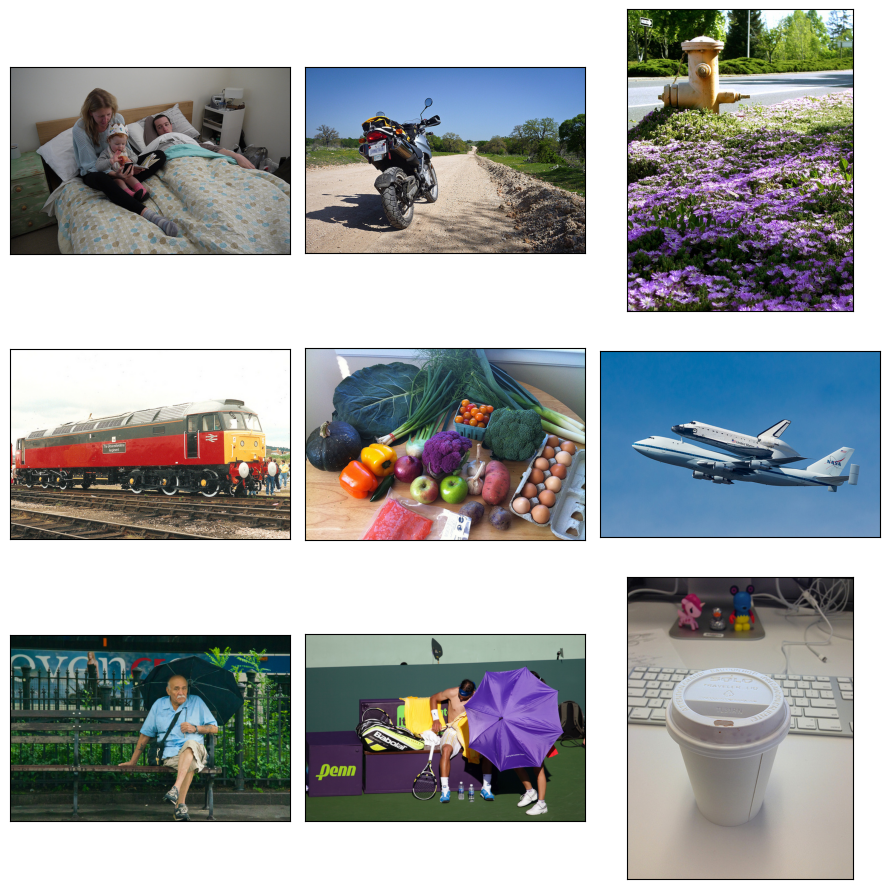

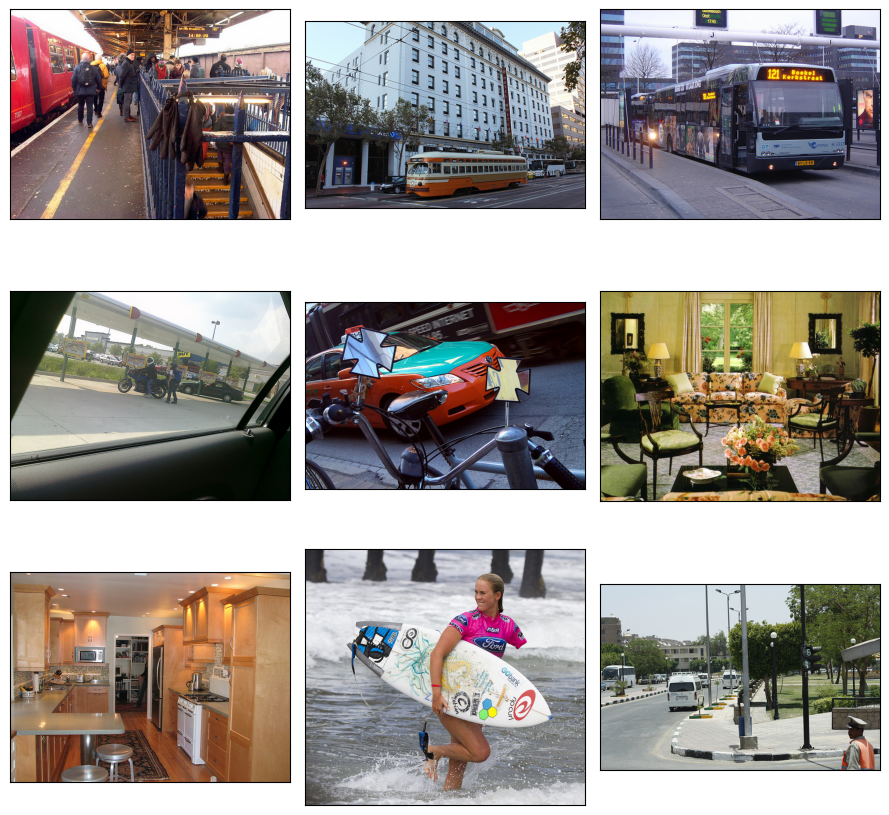

In [5]:
simple_images = []
complex_images = []

for im in vg.get_images():
    stats = vg.get_image_statistics(im)
    if(stats["# of unique objects"] < 20 and stats["# of unique objects"] > 5):
        simple_images.append(im)
    elif stats["# of unique objects"] > 30:
        complex_images.append(im)
        
# sample 9 images from simple_images and 9 images from complex_images
# shuffle
import random
random.shuffle(simple_images)
random.shuffle(complex_images)

simple_images = simple_images[:9]
complex_images = complex_images[:9]

vg.visualize_images_side_by_side(simple_images)
vg.visualize_images_side_by_side(complex_images)


In [7]:
scene_graph = vg.generate_scene_graph_json(simple_images[0].id)

import json
# save to graph.json
with open(f"../graphviz/scene_graph.json", "w") as f:
    json.dump(scene_graph, f)

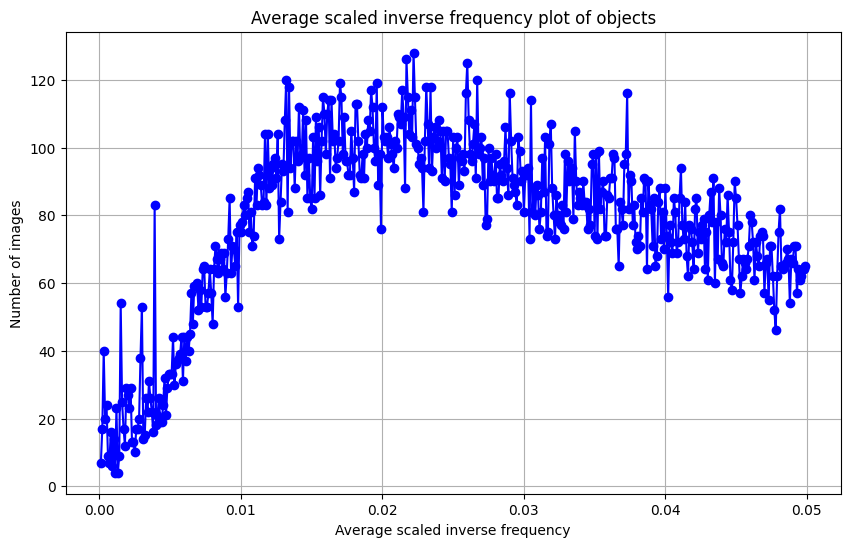

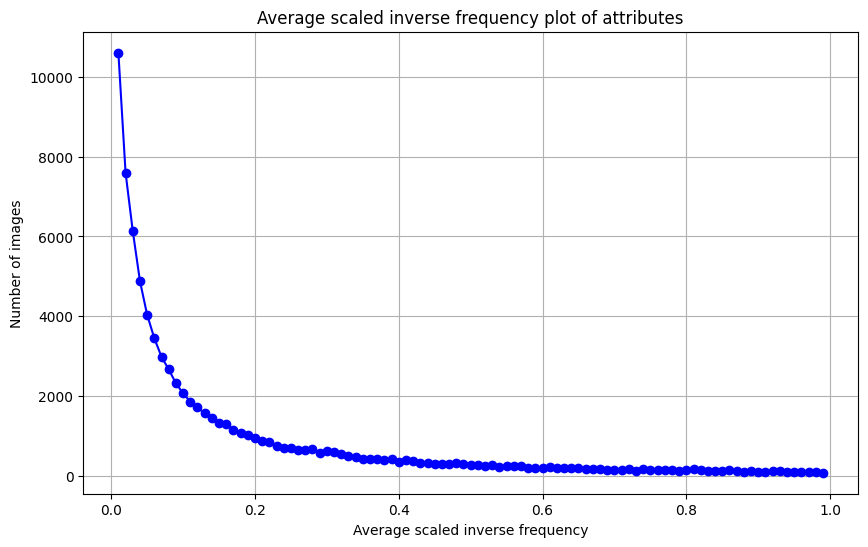

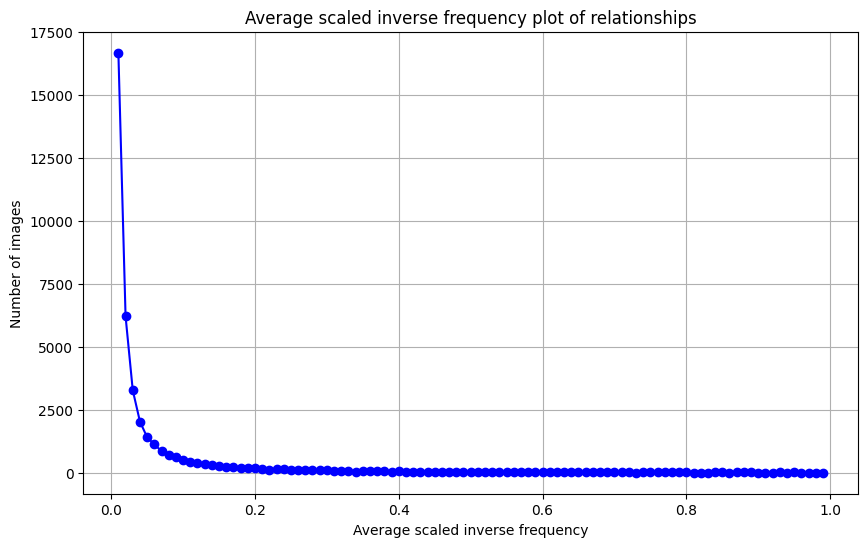

In [8]:
vg.average_inv_frequency_plot("objects", 500)
vg.average_inv_frequency_plot("attributes", 100)
vg.average_inv_frequency_plot("relationships", 100)

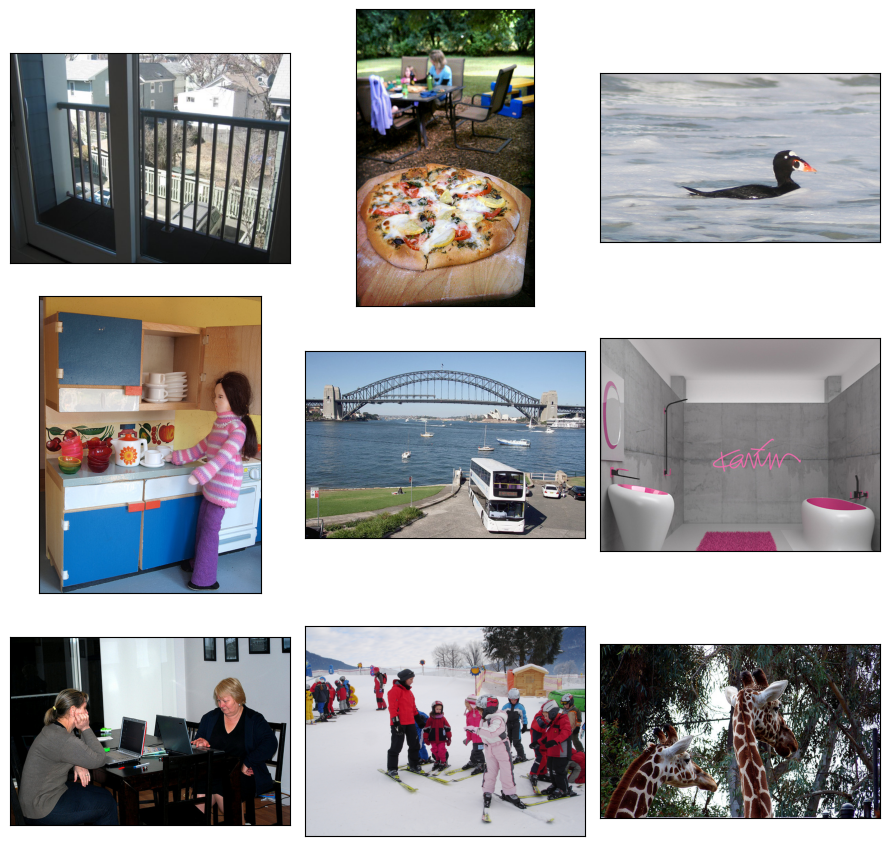

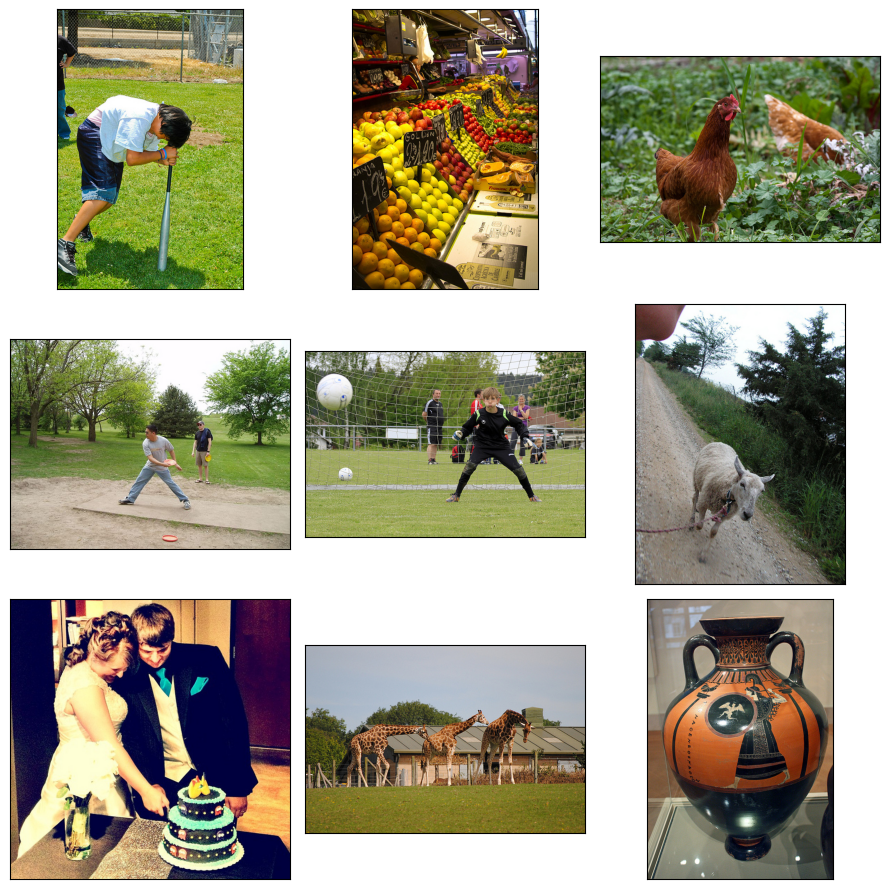

In [9]:
simple_imgs = vg.sample_images_with_inv_frequency("relationships", lo=0.01, hi=0.015, cnt=9)
vg.visualize_images_side_by_side(simple_imgs)

complex_images = vg.sample_images_with_inv_frequency("relationships", lo=0.015, hi=0.2, cnt=9)
vg.visualize_images_side_by_side(complex_images)

In [10]:
for im in complex_images:
    rels = vg.get_image_relationships(im)
    freqs = {}
    for rel in rels:
        if rel.synset:
            freqs[rel.synset] = vg.rel_inv_freq[rel.synset]

    # sort by frequency
    sorted_freqs = sorted(freqs.items(), key=lambda x: -x[1])
    # print first 3 elements
    for syn, freq in sorted_freqs[:3]:
        print(f"{syn}: {freq}")
    
    most_contrib = sorted_freqs[0][0]
    list_ = []
    print(f"Most contributive relationship: {most_contrib}")
    for rel in rels:
        if most_contrib == rel.synset:
            list_.append(rel)
            
    print(list_)
    

not.r.01: 0.90067866475188
surround.v.01: 0.11088710380732683
behind.r.01: 0.004258852293824684
Most contributive relationship: not.r.01
[id: 4181155: boy not wearing socks, synset: not.r.01]
depart.v.03: 0.1258794311093348
fill.v.01: 0.11393125066444944
above.r.01: 0.012659049919733462
Most contributive relationship: depart.v.03
[id: 3757919: eyes part of woman, synset: depart.v.03, id: 3757912: nose part of woman, synset: depart.v.03]
bend.v.01: 0.4737104556383595
walk.v.01: 0.019896512990455795
in.r.01: 0.0006105187116905665
Most contributive relationship: bend.v.01
[id: 2356628: hen bent over in grass, synset: bend.v.01]
get_down.v.07: 0.3399125607212552
fully.r.01: 0.14491394999038887
wear.v.01: 0.001123310149352474
Most contributive relationship: get_down.v.07
[id: 3866456: man getting ready to throw frisbee, synset: get_down.v.07]
through.r.01: 0.1749074847771286
outside.r.01: 0.0865814937449885
play.v.01: 0.03452217307637445
Most contributive relationship: through.r.01
[id: 103

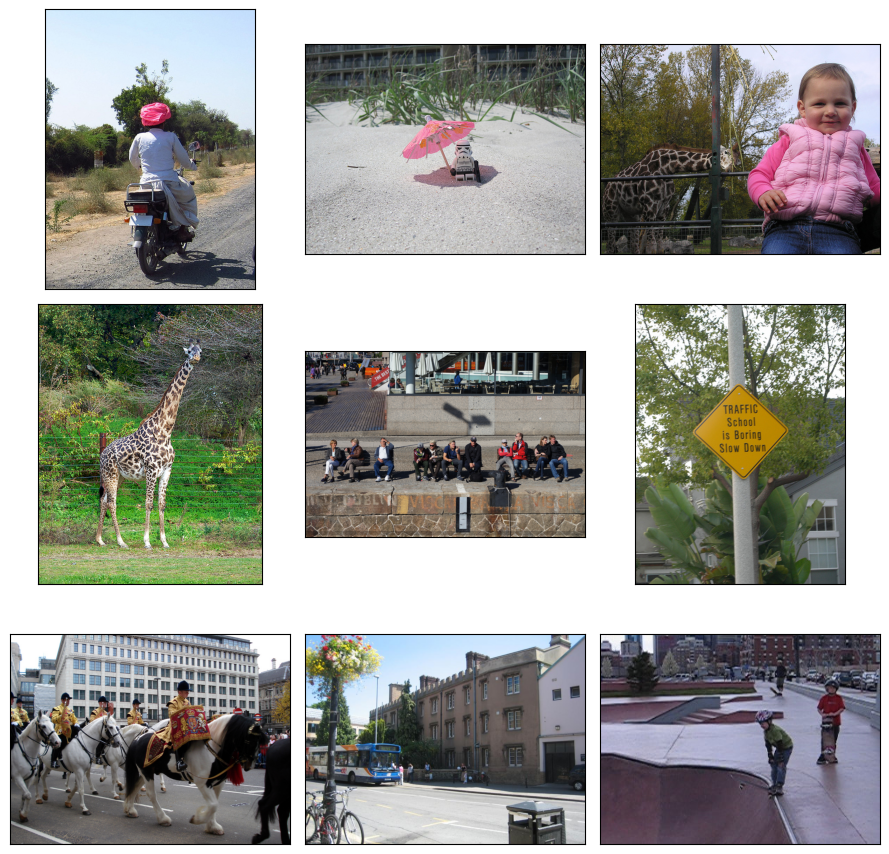

In [11]:
simple_imgs = vg.sample_images_with_inv_frequency("objects", lo=0.000, hi=0.025, cnt=9)
vg.visualize_images_side_by_side(simple_imgs)

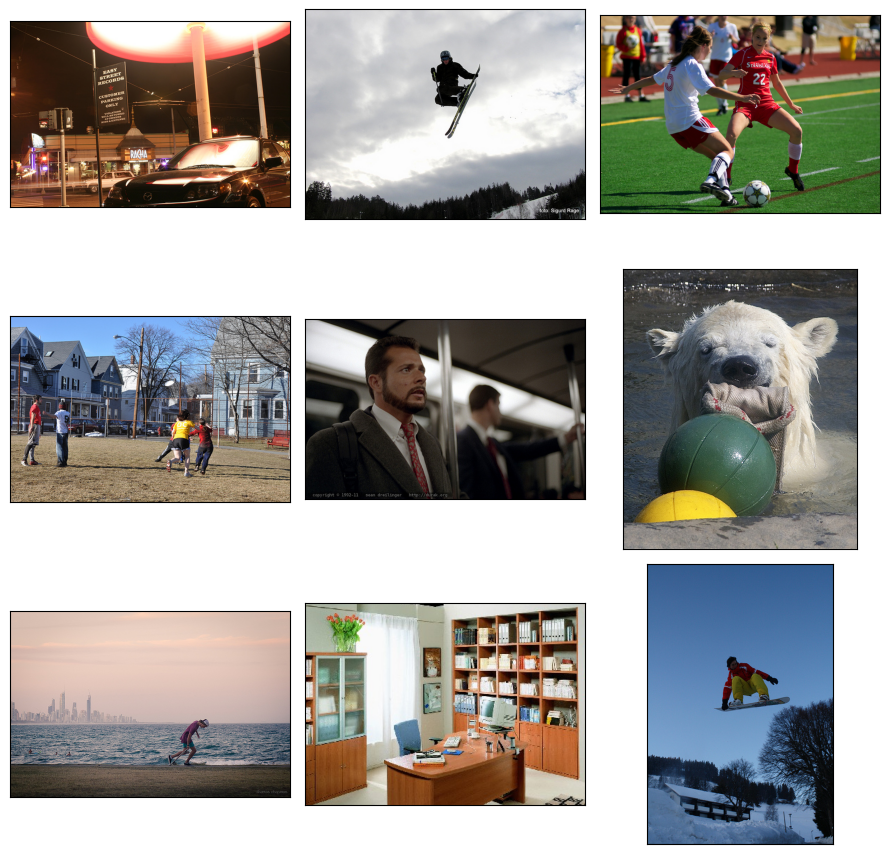

In [12]:
complex_imgs = vg.sample_images_with_inv_frequency("objects", lo=0.025, hi=0.050, cnt=9)
vg.visualize_images_side_by_side(complex_imgs)

emblem.n.01: 0.16227668071984808
crossing.n.05: 0.15532801038342256
grillroom.n.01: 0.13978459672291807
Most contributive object: emblem.n.01


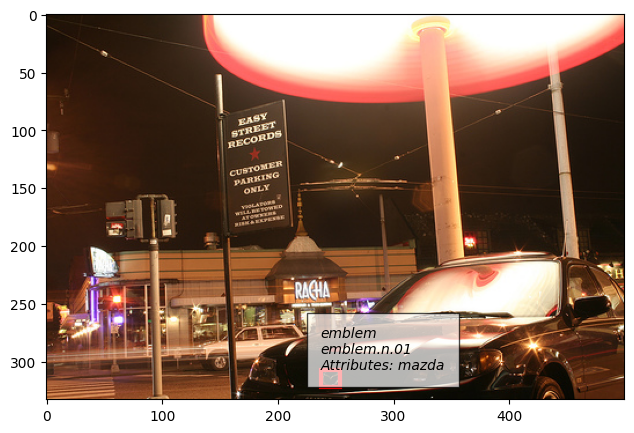

skier.n.01: 0.06997395968137292
ski_pole.n.01: 0.062238356992255536
hand.n.01: 0.002227470691071826
Most contributive object: skier.n.01


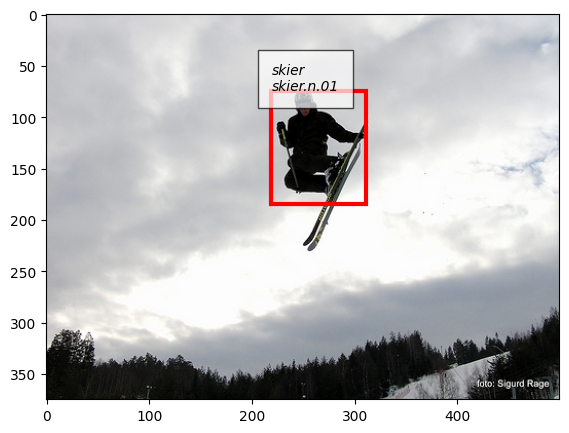

female.n.01: 0.3168161581052817
bin.n.01: 0.13275036637413867
new_jersey.n.01: 0.064347229090603
Most contributive object: female.n.01


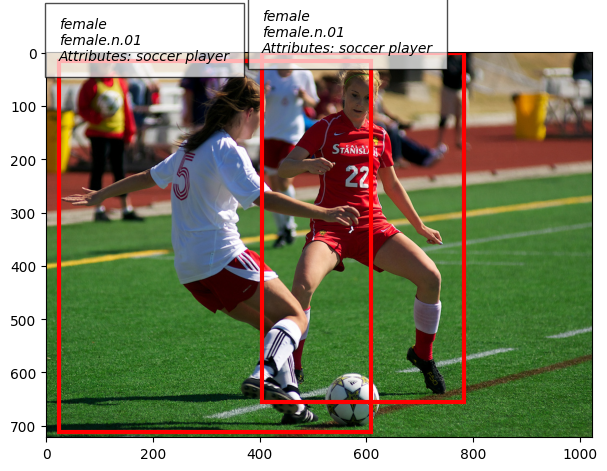

homo.n.02: 0.6044102019128587
frisbee.n.01: 0.05184496872457326
house.n.01: 0.019780711757864975
Most contributive object: homo.n.02


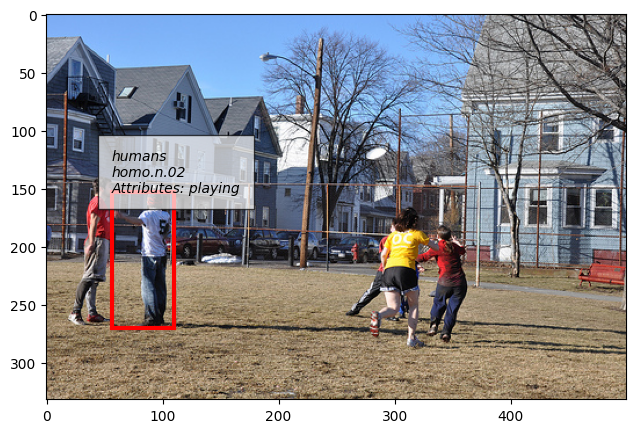

cheek.n.01: 0.2768956897036579
beard.n.01: 0.0819529608969324
shoulder.n.01: 0.06549981479485764
Most contributive object: cheek.n.01


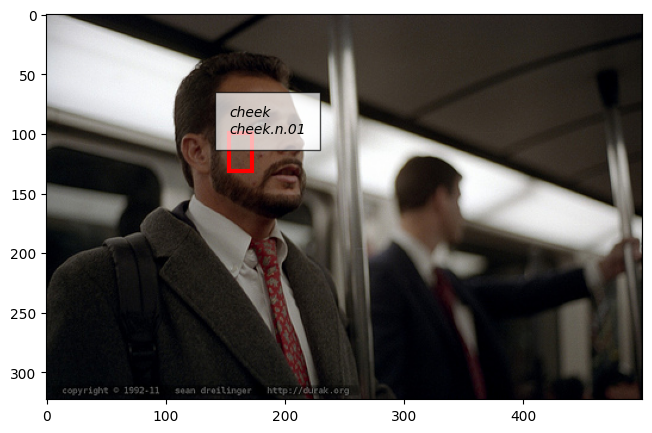

cement.n.01: 0.1336597766174527
marker.n.02: 0.10739259726247745
tooth.n.01: 0.07230525761024718
Most contributive object: cement.n.01


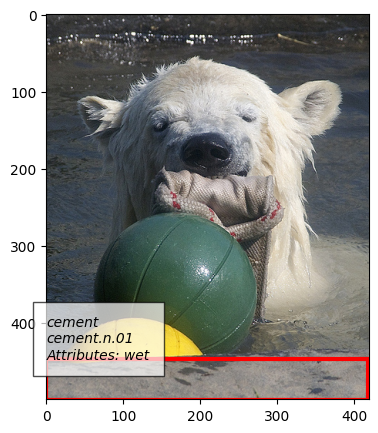

horizon.n.01: 0.13402699573334176
city.n.01: 0.10007062139257927
beach.n.01: 0.030146676326954433
Most contributive object: horizon.n.01


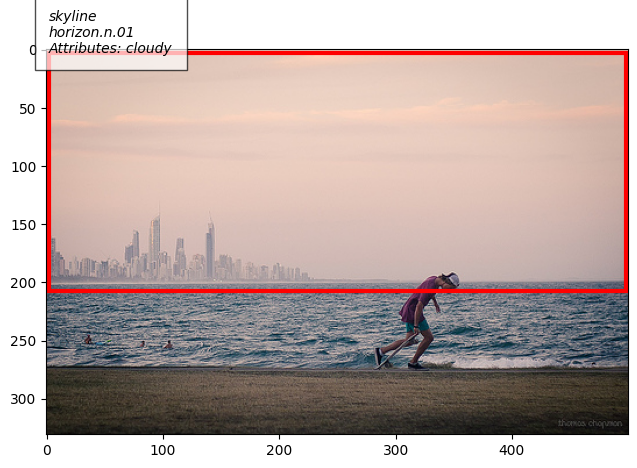

bookshelf.n.01: 0.25944047358096356
utensil.n.01: 0.10327306910444448
monitor.n.04: 0.07473499495441109
Most contributive object: bookshelf.n.01


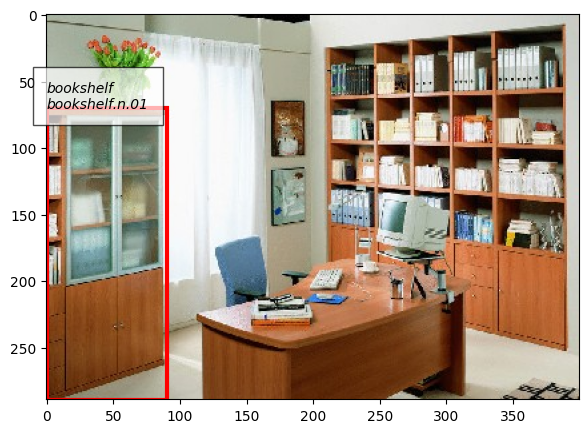

marker.n.01: 0.21812340157186066
boot.n.01: 0.030319596520925862
hill.n.01: 0.02220058239266319
Most contributive object: marker.n.01


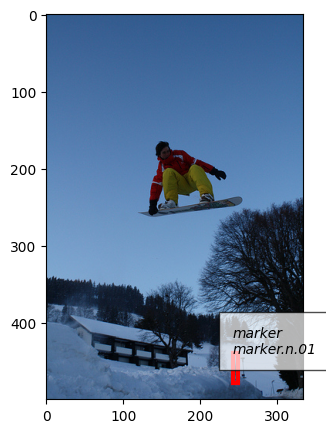

In [13]:
for im in complex_imgs:
    objs = vg.get_image_objects(im)
    freqs = {}
    for obj in objs:
        for syn in obj.synsets:
            freqs[syn] = vg.obj_inv_freq[syn]

    # sort by frequency
    sorted_freqs = sorted(freqs.items(), key=lambda x: -x[1])
    # print first 3 elements
    for syn, freq in sorted_freqs[:3]:
        print(f"{syn}: {freq}")
    
    most_contrib = sorted_freqs[0][0]
    list_ = []
    print(f"Most contributive object: {most_contrib}")
    for obj in objs:
        if most_contrib in obj.synsets:
            list_.append(obj.id)
    vg.visualize_objects(im.id, object_ids = list_)

## Color Variability

In [14]:
imgs = vg.sample_image_ids(9)

Image ID: 2369476
Color Variability Entropy: 2.9606306976451604


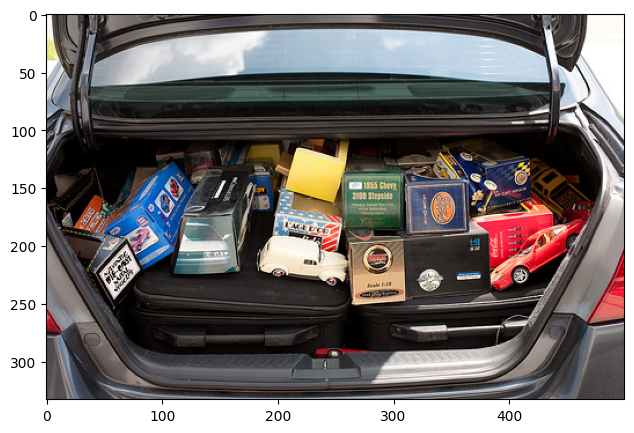

Image ID: 2330738
Color Variability Entropy: 2.548044925676076


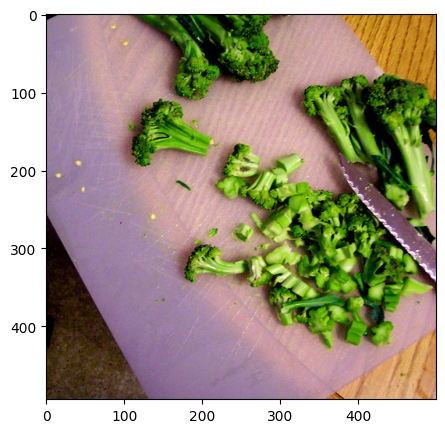

Image ID: 2406600
Color Variability Entropy: 2.6437029740820983


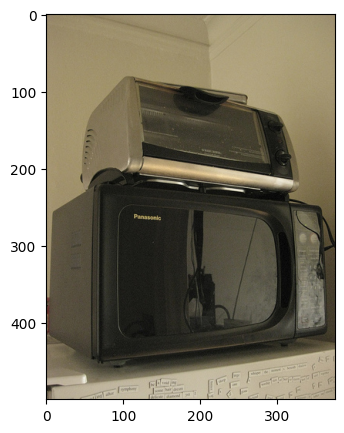

Image ID: 2386749
Color Variability Entropy: 2.1497640662357265


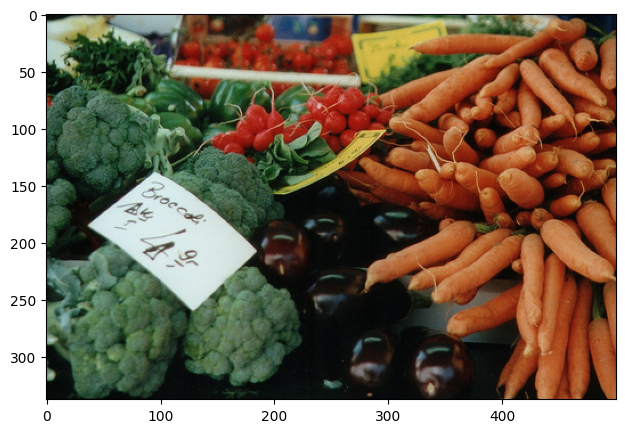

Image ID: 2836
Color Variability Entropy: 1.3244979379187083


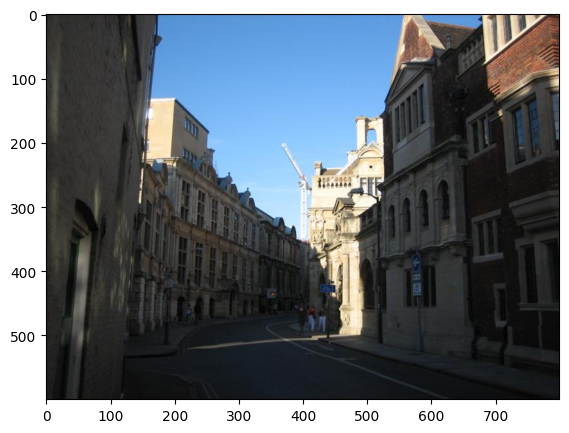

Image ID: 2329490
Color Variability Entropy: 3.379923123321035


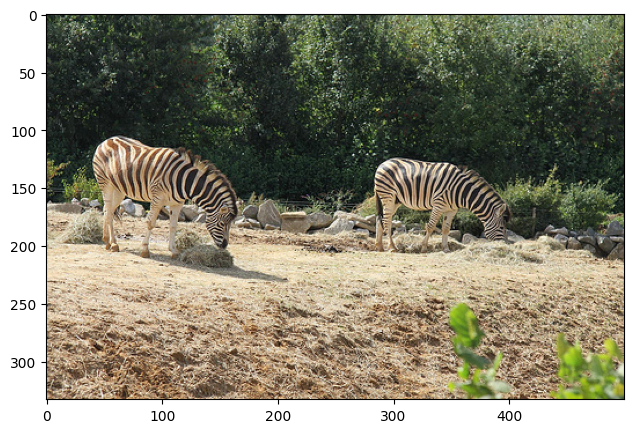

Image ID: 2348496
Color Variability Entropy: 3.0859779132056397


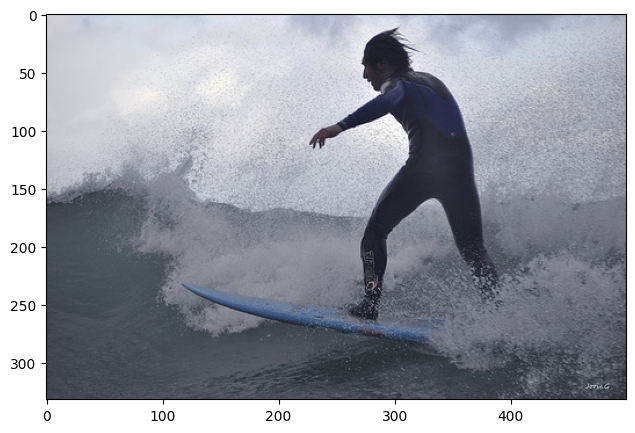

Image ID: 2364097
Color Variability Entropy: 3.1590090174325587


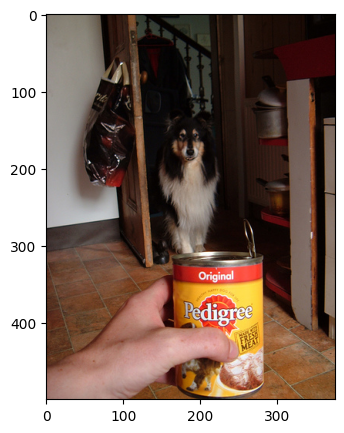

Image ID: 2317861
Color Variability Entropy: 2.722851782548009


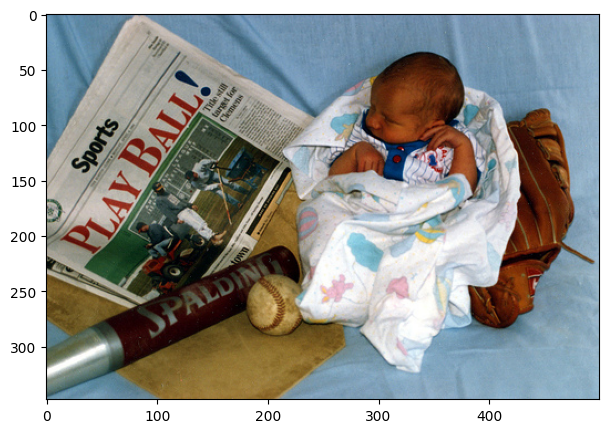

{2329490: np.float64(3.379923123321035), 2364097: np.float64(3.1590090174325587), 2348496: np.float64(3.0859779132056397), 2369476: np.float64(2.9606306976451604), 2317861: np.float64(2.722851782548009), 2406600: np.float64(2.6437029740820983), 2330738: np.float64(2.548044925676076), 2386749: np.float64(2.1497640662357265), 2836: np.float64(1.3244979379187083)}


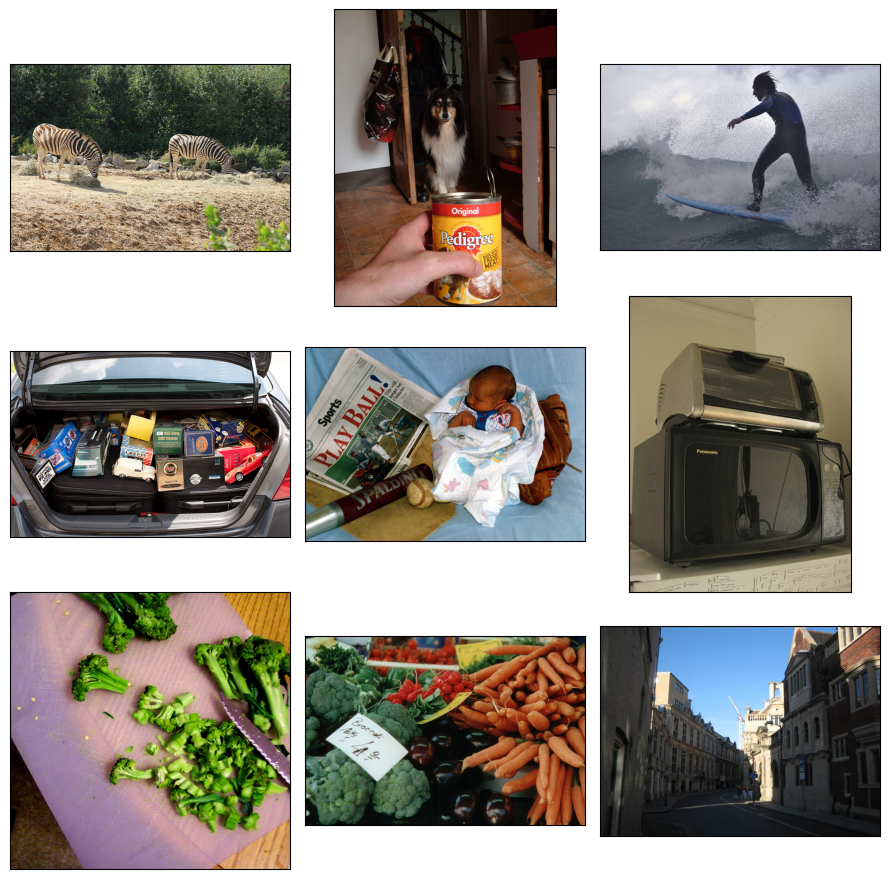

In [15]:
import cv2
import numpy as np
import requests
from io import BytesIO
from scipy.stats import entropy

# Function to fetch and decode the image
def fetch_image_from_url(image_url):
    # Fetch the image from the URL
    response = requests.get(image_url)
    image_np = np.asarray(bytearray(response.content), dtype="uint8")
    # Decode the image using OpenCV
    image = cv2.imdecode(image_np, cv2.IMREAD_COLOR)
    return image

# Function to calculate color variability for an object's region in the image
def get_object_color_variability(image_rgb, obj):
    # Extract object bounding box (x, y is the upper-left corner, width and height)
    x, y, width, height = obj.x, obj.y, obj.width, obj.height
    
    # Crop the object's region from the image using the bounding box
    object_region = image_rgb[y:y+height, x:x+width]

    # Split the object region into R, G, B channels
    r, g, b = cv2.split(object_region)

    # Calculate the standard deviation for each channel
    r_std = np.std(r)
    g_std = np.std(g)
    b_std = np.std(b)

    # Calculate mean color variability for the object
    color_variability = np.mean([r_std, g_std, b_std])

    return color_variability

# Function to calculate the entropy of color variabilities among objects
def get_color_variability_entropy(image_url, objects):
    # Fetch the image
    image = fetch_image_from_url(image_url)
    
    # Convert the image to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Store color variability values for all objects
    variability_list = []

    # Loop over all objects and calculate color variability for each
    for obj in objects:
        variability = get_object_color_variability(image_rgb, obj)
        variability_list.append(variability)
    
    # Normalize the color variability list to make it a valid probability distribution
    variability_array = np.array(variability_list)
    variability_probs = variability_array / np.sum(variability_array)  # Normalize to sum to 1

    # Calculate the entropy of the color variability distribution
    color_variability_entropy = entropy(variability_probs)
    
    print(f"Color Variability Entropy: {color_variability_entropy}")
    
    return color_variability_entropy

# Example usage
# Assuming vg.get_image_objects(im.id) returns a list of Object instances
# And img.url contains the image URL
sorted_ = {}
# Example for-loop to process multiple images
for im in imgs:
    img = vg.get_image(im)
    objects = vg.get_image_objects(im)  # Get list of objects in the image
    print(f"Image ID: {im}")
    
    # Calculate entropy of color variability across all objects in the image
    entropy_value = get_color_variability_entropy(img.url, objects)
    sorted_[im] = entropy_value
    # Visualize the objects
    vg.visualize_objects(im, 0)

sorted_ = dict(sorted(sorted_.items(), key=lambda item: item[1], reverse=True))
print(sorted_)
images = list(sorted_.keys())
vg.visualize_images_side_by_side(images[:9])

## Color Histogram Analysis

Image ID: id: 2325923, coco_id: -1, flickr_id: 6934556615, width: 375, url: https://cs.stanford.edu/people/rak248/VG_100K/2325923.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/2325923.jpg: 0.9956269860267639


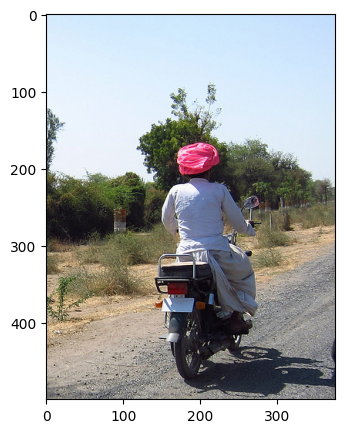

Image ID: id: 2398127, coco_id: 153288, flickr_id: 5747621161, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K_2/2398127.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/2398127.jpg: 0.5410420298576355


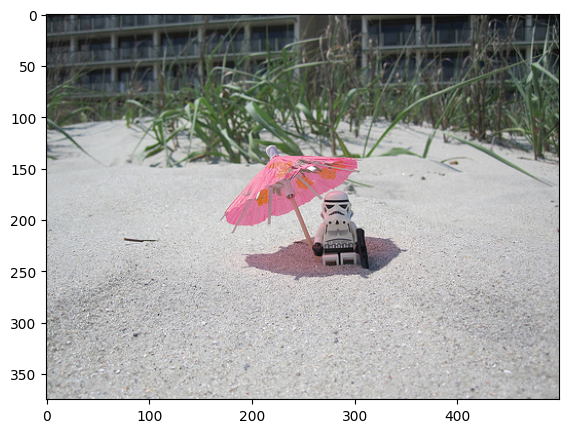

Image ID: id: 2358438, coco_id: 524677, flickr_id: 258379393, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K/2358438.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/2358438.jpg: 0.5071456432342529


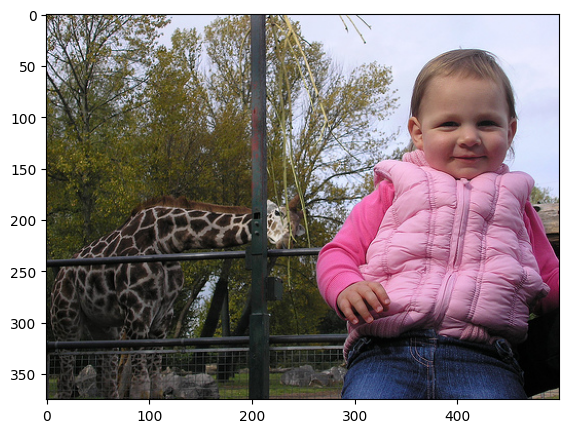

Image ID: id: 2383325, coco_id: 124190, flickr_id: 8132767307, width: 400, url: https://cs.stanford.edu/people/rak248/VG_100K_2/2383325.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/2383325.jpg: 0.5226066708564758


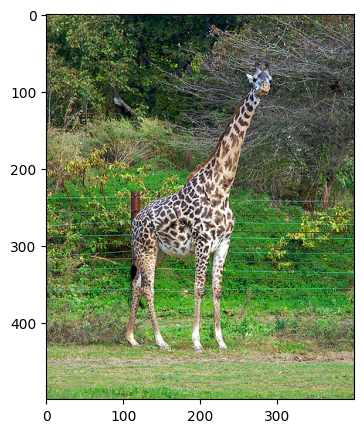

Image ID: id: 1593066, coco_id: 158794, flickr_id: 8489260810, width: 1024, url: https://cs.stanford.edu/people/rak248/VG_100K/1593066.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/1593066.jpg: 0.575201690196991


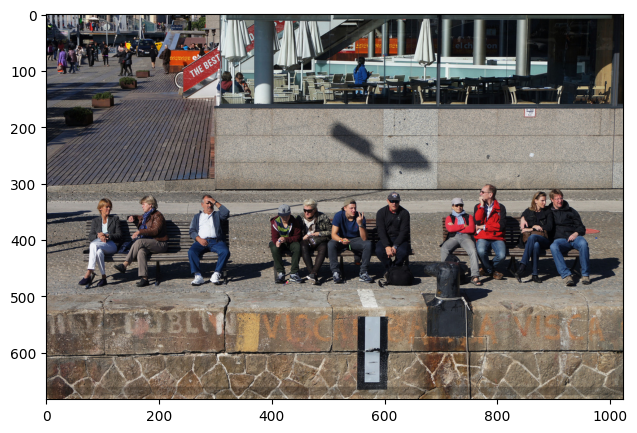

Image ID: id: 2328097, coco_id: 561119, flickr_id: 321004686, width: 375, url: https://cs.stanford.edu/people/rak248/VG_100K/2328097.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/2328097.jpg: 0.3610149323940277


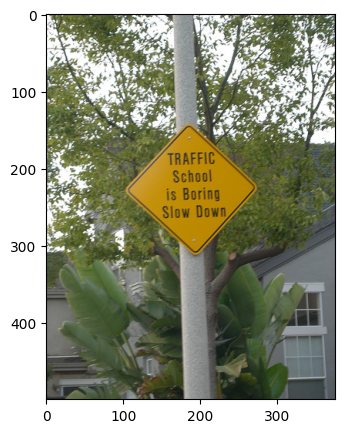

Image ID: id: 1592356, coco_id: 448547, flickr_id: 294962708, width: 1024, url: https://cs.stanford.edu/people/rak248/VG_100K/1592356.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/1592356.jpg: 0.5054935812950134


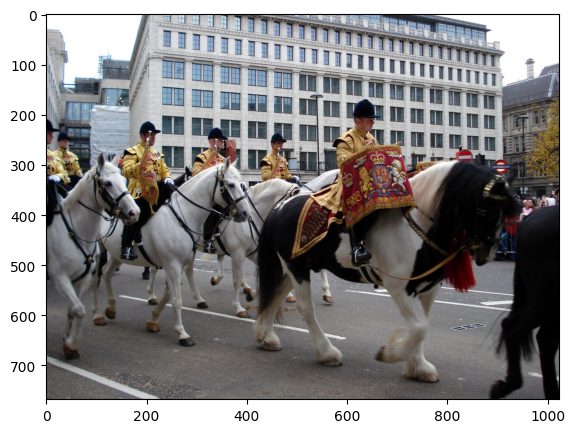

Image ID: id: 55, coco_id: -1, flickr_id: -1, width: 800, url: https://cs.stanford.edu/people/rak248/VG_100K_2/55.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/55.jpg: 0.4519226849079132


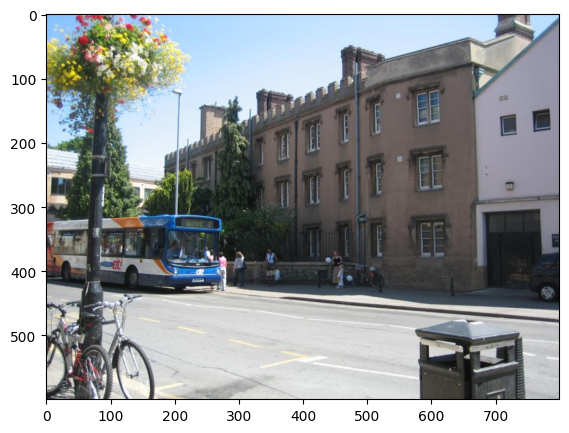

Image ID: id: 2334055, coco_id: -1, flickr_id: 3241674774, width: 320, url: https://cs.stanford.edu/people/rak248/VG_100K/2334055.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/2334055.jpg: 0.32993242144584656


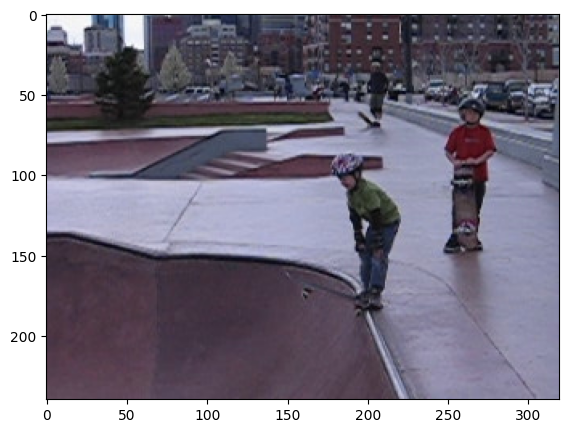

{2325923: np.float32(0.995627), 1593066: np.float32(0.5752017), 2398127: np.float32(0.54104203), 2383325: np.float32(0.5226067), 2358438: np.float32(0.50714564), 1592356: np.float32(0.5054936), 55: np.float32(0.45192268), 2328097: np.float32(0.36101493), 2334055: np.float32(0.32993242)}


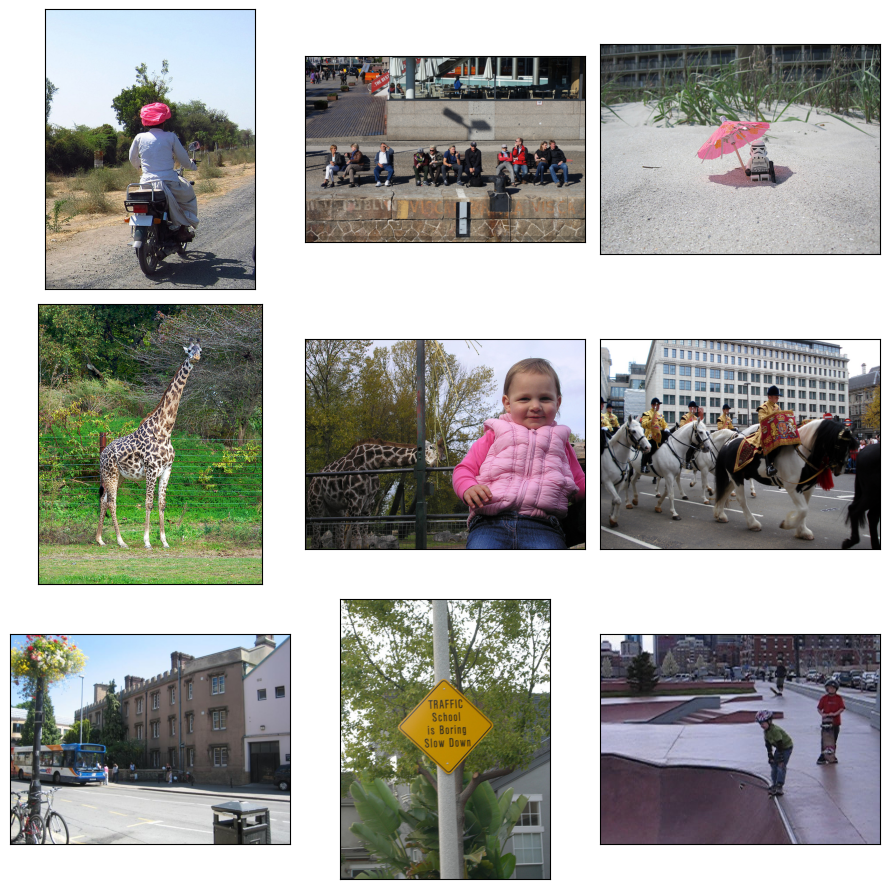

In [16]:
import cv2
import numpy as np
import requests

def get_bounding_box(image, obj):
    # Assuming obj has properties x, y, width, height
    return image[obj.y:obj.y + obj.height, obj.x:obj.x + obj.width]

def compute_color_histogram(region):
    # Compute the histogram for the BGR channels
    hist_b = cv2.calcHist([region], [0], None, [256], [0, 256])
    hist_g = cv2.calcHist([region], [1], None, [256], [0, 256])
    hist_r = cv2.calcHist([region], [2], None, [256], [0, 256])
    
    # Normalize histograms to sum to 1
    hist_b = hist_b / np.sum(hist_b)
    hist_g = hist_g / np.sum(hist_g)
    hist_r = hist_r / np.sum(hist_r)
    
    return hist_b.flatten(), hist_g.flatten(), hist_r.flatten()

def histogram_intersection(hist_a, hist_b):
    return np.sum(np.minimum(hist_a, hist_b))

def calculate_color_variability(image_url, objects):
    # Fetch the image from the URL
    response = requests.get(image_url)
    image_np = np.asarray(bytearray(response.content), dtype="uint8")
    
    # Decode the image using OpenCV
    image = cv2.imdecode(image_np, cv2.IMREAD_COLOR)
    
    # Initialize a list to hold histograms
    histograms = []

    # Compute the color histogram for each object
    for obj in objects:
        object_region = get_bounding_box(image, obj)
        hist_b, hist_g, hist_r = compute_color_histogram(object_region)
        histograms.append((hist_b, hist_g, hist_r))

    # Compute the pairwise histogram intersection
    similarities = {0: [], 1: [], 2: []}
    for key in similarities.keys():
        for i in range(len(histograms)):
            for j in range(i + 1, len(histograms)):
                hist_a = histograms[i][key]
                hist_b = histograms[j][key]
                similarity = histogram_intersection(hist_a, hist_b)
                similarities[key].append(similarity)
    
    # First compute average similarity for each channel
    # Then compute the overall similarity as the mean of the channel similarities
    # Higher similarity means that objects are more similar in color
    overall_similarity = np.mean([np.mean(similarities[0]), np.mean(similarities[1]), np.mean(similarities[2])])
    return overall_similarity

# Example for-loop to process multiple images
sorted_ = {}
for im in simple_imgs:
    img = vg.get_image(im.id)
    objects = vg.get_image_objects(im.id)  # Get list of objects in the image
    print(f"Image ID: {im}")
    color_variability = calculate_color_variability(im.url, objects)
    print(f"Overall Color Variability for {im.url}: {color_variability}")
    
    sorted_[im.id] = color_variability
    # Visualize the objects
    vg.visualize_objects(im.id, 0)
    
sorted_ = dict(sorted(sorted_.items(), key=lambda item: item[1], reverse=True))
print(sorted_)
images = list(sorted_.keys())
vg.visualize_images_side_by_side(images[:9])



In [17]:
vg.get_image_objects(2392605)

[]

## Simple Averaging

Image ID: id: 414, coco_id: -1, flickr_id: -1, width: 256, url: https://cs.stanford.edu/people/rak248/VG_100K_2/414.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/414.jpg: 572.2422753747828


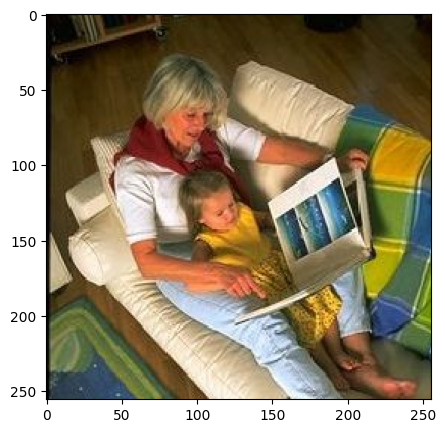

Image ID: id: 2384739, coco_id: -1, flickr_id: 2142966473, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K_2/2384739.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/2384739.jpg: 1305.1939137520692


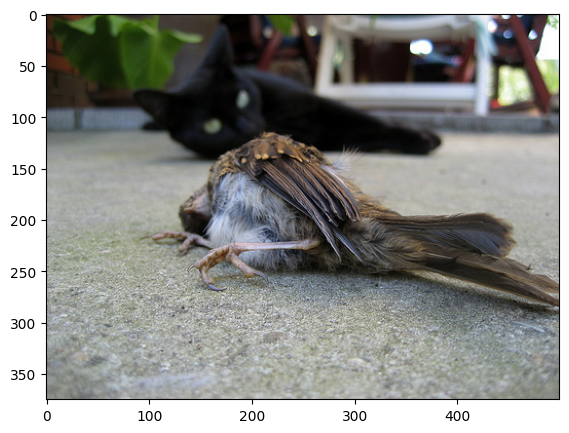

Image ID: id: 2388959, coco_id: -1, flickr_id: 6054615198, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K_2/2388959.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/2388959.jpg: 1681.0222091788282


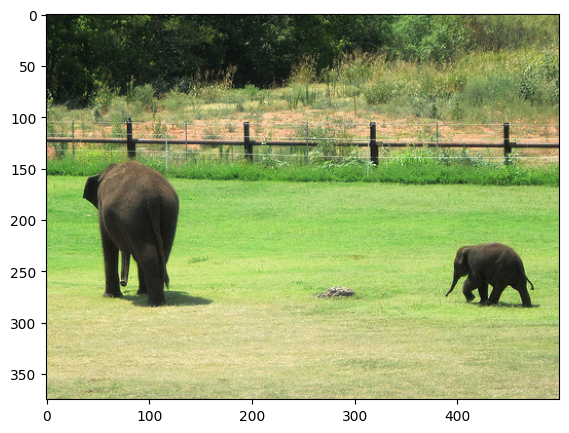

Image ID: id: 2403089, coco_id: -1, flickr_id: 4550015696, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K_2/2403089.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/2403089.jpg: 893.0478297295762


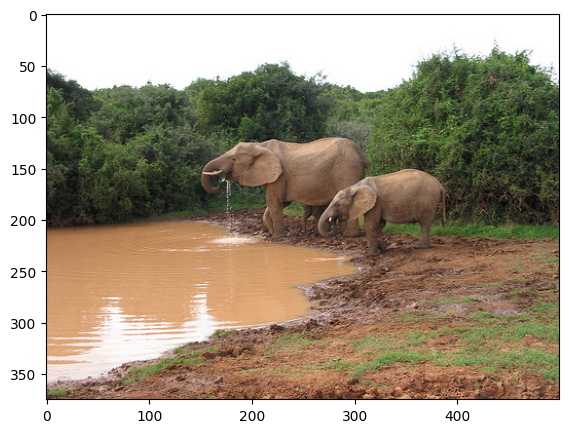

Image ID: id: 2392605, coco_id: 87851, flickr_id: 4935398523, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K_2/2392605.jpg


c:\Users\karab\Desktop\Visual Genome Driver\env\lib\site-packages\numpy\_core\fromnumeric.py:4008: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\Users\karab\Desktop\Visual Genome Driver\env\lib\site-packages\numpy\_core\_methods.py:175: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
c:\Users\karab\Desktop\Visual Genome Driver\env\lib\site-packages\numpy\_core\_methods.py:210: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/2392605.jpg: nan


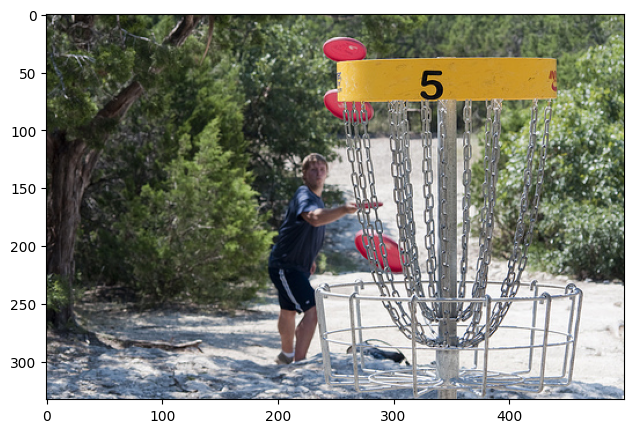

Image ID: id: 2332477, coco_id: 572215, flickr_id: 6973940759, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K/2332477.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/2332477.jpg: 618.918136274706


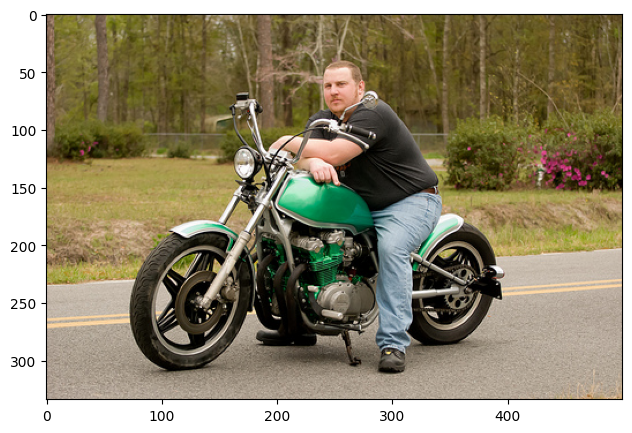

Image ID: id: 2338431, coco_id: 384834, flickr_id: 5949623252, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K/2338431.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/2338431.jpg: 0.0


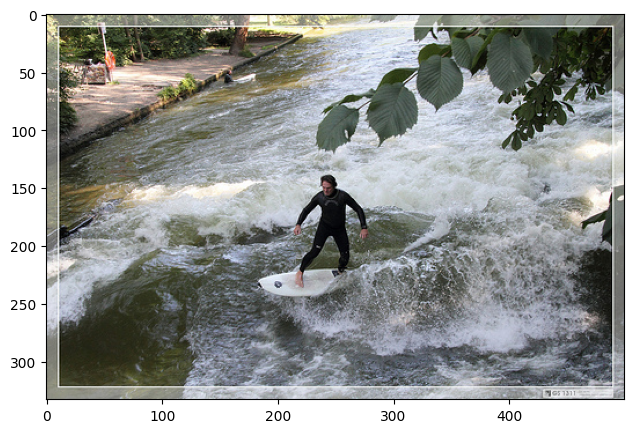

Image ID: id: 2321329, coco_id: 536290, flickr_id: 6088832136, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K/2321329.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K/2321329.jpg: 1265.524190855894


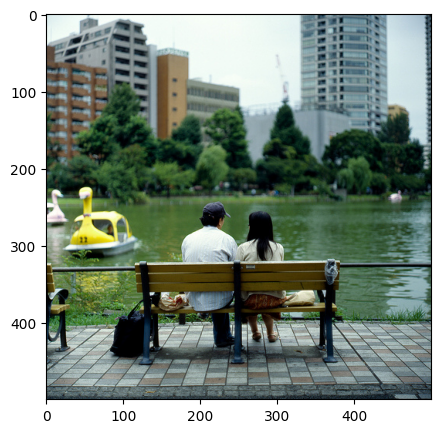

Image ID: id: 2408693, coco_id: 100034, flickr_id: 5190617934, width: 500, url: https://cs.stanford.edu/people/rak248/VG_100K_2/2408693.jpg
Overall Color Variability for https://cs.stanford.edu/people/rak248/VG_100K_2/2408693.jpg: 1873.8693316137972


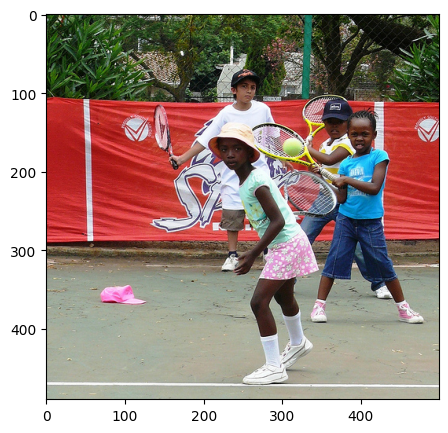

{2388959: np.float64(1681.0222091788282), 2384739: np.float64(1305.1939137520692), 2392605: np.float64(nan), 2408693: np.float64(1873.8693316137972), 2321329: np.float64(1265.524190855894), 2403089: np.float64(893.0478297295762), 2332477: np.float64(618.918136274706), 414: np.float64(572.2422753747828), 2338431: np.float64(0.0)}


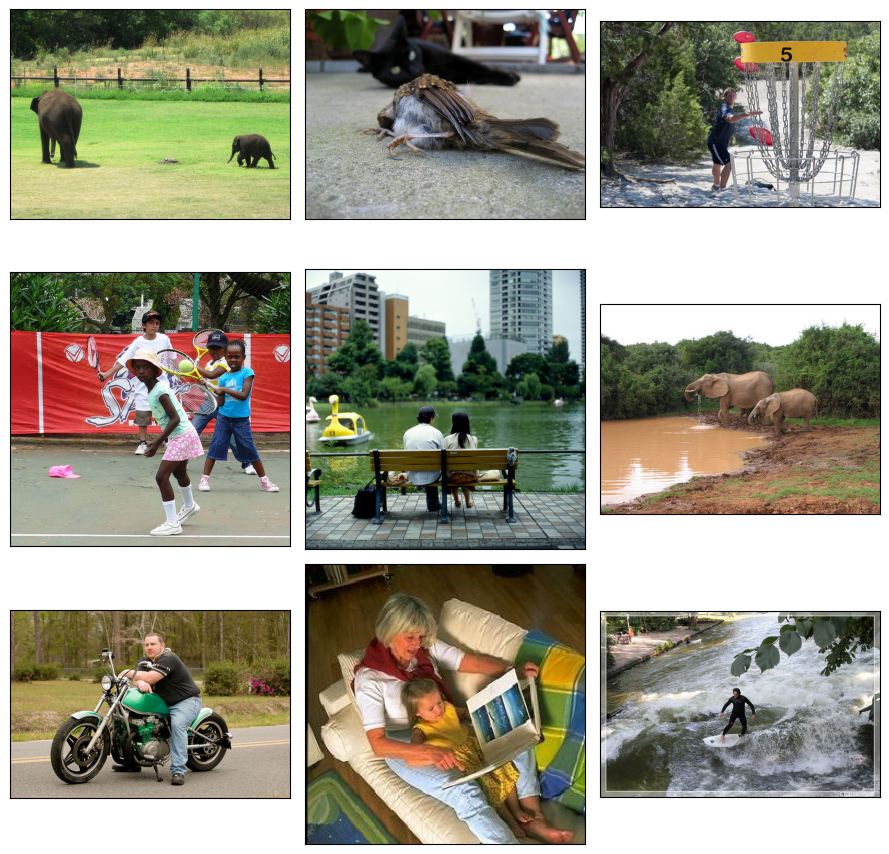

In [9]:
import cv2
import numpy as np
import requests

def get_bounding_box(image, obj):
    # Assuming obj has properties x, y, width, height
    return image[obj.y:obj.y + obj.height, obj.x:obj.x + obj.width]

def calculate_mean_color(region):
    # Calculate the mean color for the region
    mean_color = cv2.mean(region)[:3]  # Returns (B, G, R, A)
    return mean_color  # Return only (R, G, B)

def calculate_color_variability(image_url, objects):
    # Fetch the image from the URL
    response = requests.get(image_url)
    image_np = np.asarray(bytearray(response.content), dtype="uint8")
    
    # Decode the image using OpenCV
    image = cv2.imdecode(image_np, cv2.IMREAD_COLOR)

    mean_colors = []

    # Compute the mean color for each object
    for obj in objects:
        object_region = get_bounding_box(image, obj)
        mean_color = calculate_mean_color(object_region)
        mean_colors.append(mean_color)

    mean_colors = np.array(mean_colors)
    
    # Calculate variance among mean colors for each channel
    variance = np.var(mean_colors, axis=0)  # Variance across mean R, G, B values
    combined_variance = np.mean(variance)
    return combined_variance

# Example for-loop to process multiple images
sorted_ = {}
for im in simple_imgs:
    img = vg.get_image(im.id)
    objects = vg.get_image_objects(im.id)  # Get list of objects in the image
    print(f"Image ID: {im}")
    color_variability = calculate_color_variability(im.url, objects)
    print(f"Overall Color Variability for {im.url}: {color_variability}")
    
    sorted_[im.id] = color_variability
    # Visualize the objects
    vg.visualize_objects(im.id, 0)
    
sorted_ = dict(sorted(sorted_.items(), key=lambda item: item[1], reverse=True))
print(sorted_)
images = list(sorted_.keys())
vg.visualize_images_side_by_side(images[:9])


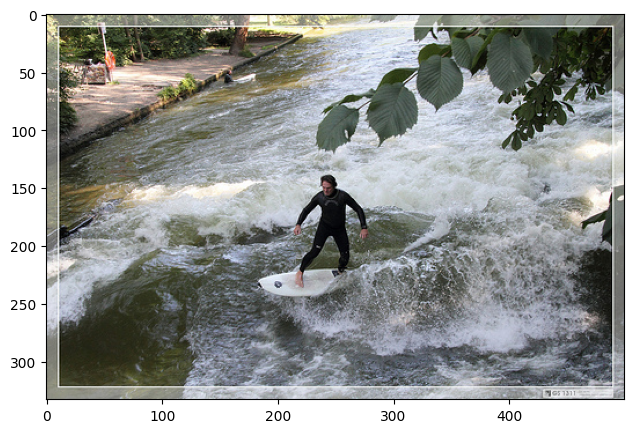

In [18]:
vg.visualize_objects(2338431, 5)